# Anomaly detection from raw images (all objects) - testing

The aim of this Notebook is to find the best model, which classifies the anomalies with the highest accuracy.

In [3]:
# import ConfigImports Notebook to import and configure libs
%run ../ConfigImports.ipynb

TF -> Using GPU ->  PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')


### No Machine Learning approach

What if we only take a look at the filenames from object recognition and look at the images with the long filenames?

The filenames are constructed in the following way: `time_unique_id_objects_separated_by_underscore.jpg`, for example `07.03.03.965_4d9909b4_person-car-car-car.jpg`.

In theory these images should contain the most unusual events during the day when many objects were detected in a single frame.

Lets load the Person and Vehicle datasets, add a new feature called `filename_len` to meansure the filename length, and sort the dataframe in descending order by that feature.

Then lets view the top 5 images and assess if this approach works.

In [37]:
# Load and concatenate datasets for Person and Vehicle objects
df1 = pd.read_csv('../Datasets/UniqueObjectDetections__person__2019-09-09_2020-03-02.csv')
df2 = pd.read_csv('../Datasets/UniqueObjectDetections__vehicle__2019-09-09_2020-03-02.csv')
df = pd.concat([df1, df2])
print(df.shape)
df.head(2)

(9571, 26)


,img_idx,label,confidence,x1,y1,x2,y2,date,time,filename,img_n_boxes,time_ms,date_time,week_day,is_weekend,month,hour,min,dummy_var,time_diff,sec_diff,x_center,y_center,prev_x_center,prev_y_center,euc_distance
0,73740,person,0.450496,459,24,478,38,2019-09-09,07.03.03,07.03.03.965_4d9909b4_person-car-car-car.jpg,2,965,2019-09-09 07:03:03.965,Monday,False,9,7,3,1,0 days 00:42:40.471000000,2560.471,468.5,31.0,490.0,310.0,279.827179
1,73135,person,0.658724,286,238,381,340,2019-09-09,07.29.50,07.29.50.440_4e0ee29d_person-car-car.jpg,1,440,2019-09-09 07:29:50.440,Monday,False,9,7,29,1,0 days 00:26:46.475000000,1606.475,333.5,289.0,468.5,31.0,291.185508


In [38]:
# Add new column
df['filename_len'] = df['filename'].str.len()

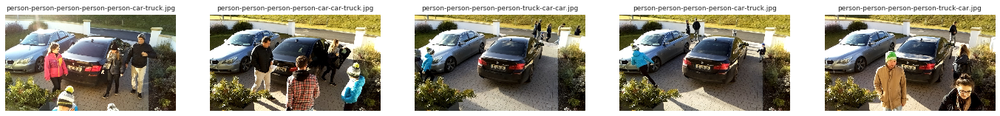

In [43]:
# Show top 5 images
IMG_BASE_DIR = '/data/security_cam_detections_v2/Front-Parking'
plt.figure(figsize=(24,10)) # specifying the overall grid size
for i, record in enumerate(df.sort_values('filename_len', ascending=False)[['filename', 'date']].head(5).values):
    plt.subplot(1, 5, i+1) # the number of images in the grid is 1*5
    fname, date = record
    img = cv2.imread(f'{IMG_BASE_DIR}/{date}/{fname}')
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.title(f'{fname.split("_")[2]}', fontsize=9)
    plt.axis('off')
plt.show()

This is actually quite good, however there are a few problems with this approach:
- it is lacking variability and very similar images are displayed
- content if the images is irrelevant
- areas outside of house boundries can not be ignored
- if the length of filename is the same across many images, they will all get the same score

Based on these drawbacks, it is clear that there must be a better way.

### Test Auto Encoder results

#### TODO: add comments about what is going on here

Model: nsamples25000_res28_blurFalse_threshFalse_polyFalse
Number of anomalies stored: 15, top 5 errors:


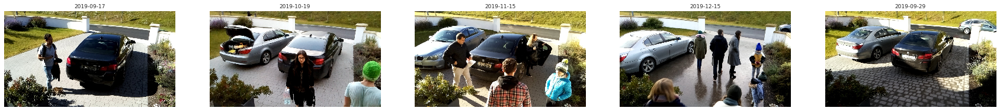

***************************
Model: nsamples25000_res28_blurFalse_threshFalse_polyTrue
Number of anomalies stored: 15, top 5 errors:


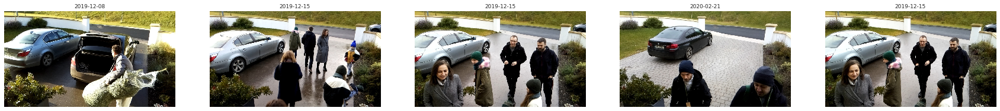

***************************
Model: nsamples25000_res28_blurFalse_threshTrue_polyFalse
Number of anomalies stored: 15, top 5 errors:


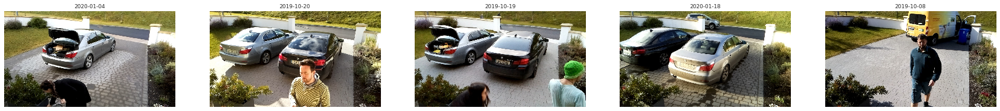

***************************
Model: nsamples25000_res28_blurFalse_threshTrue_polyTrue
Number of anomalies stored: 15, top 5 errors:


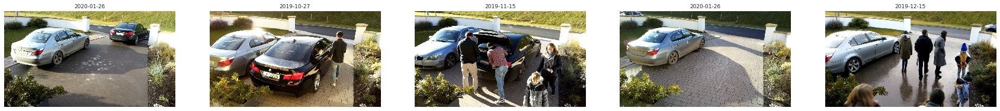

***************************
Model: nsamples25000_res28_blurTrue_threshFalse_polyFalse
Number of anomalies stored: 15, top 5 errors:


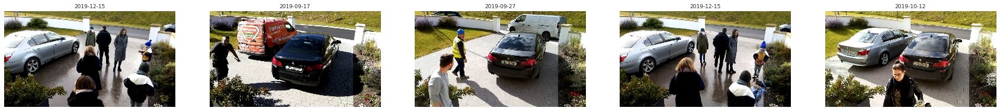

***************************
Model: nsamples25000_res28_blurTrue_threshFalse_polyTrue
Number of anomalies stored: 15, top 5 errors:


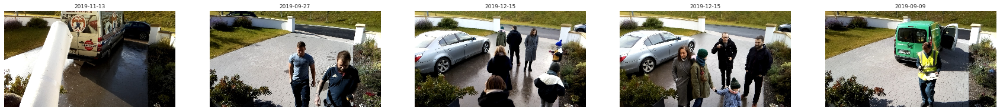

***************************
Model: nsamples25000_res28_blurTrue_threshTrue_polyFalse
Number of anomalies stored: 15, top 5 errors:


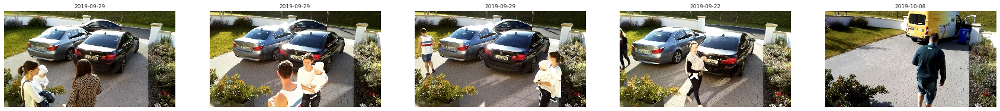

***************************
Model: nsamples25000_res28_blurTrue_threshTrue_polyTrue
Number of anomalies stored: 15, top 5 errors:


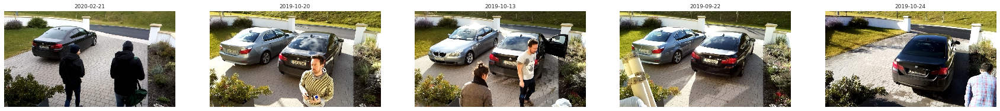

***************************
Model: nsamples25000_res56_blurFalse_threshFalse_polyFalse
Number of anomalies stored: 15, top 5 errors:


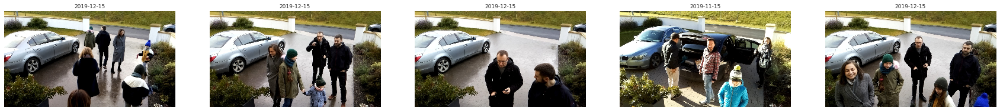

***************************
Model: nsamples25000_res56_blurFalse_threshFalse_polyTrue
Number of anomalies stored: 15, top 5 errors:


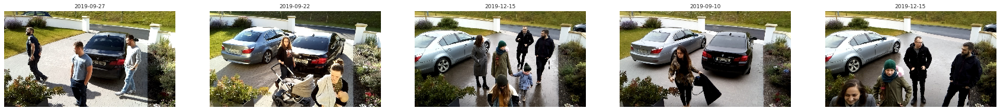

***************************
Model: nsamples25000_res56_blurFalse_threshTrue_polyFalse
Number of anomalies stored: 15, top 5 errors:


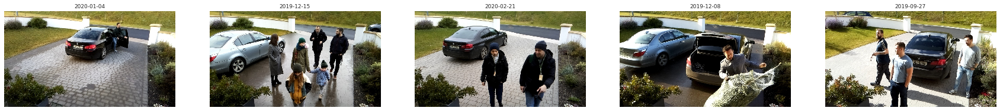

***************************
Model: nsamples25000_res56_blurFalse_threshTrue_polyTrue
Number of anomalies stored: 15, top 5 errors:


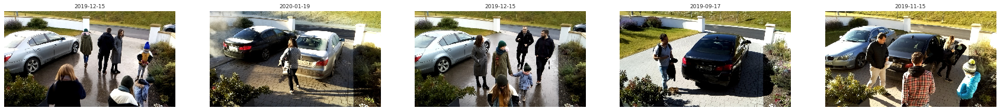

***************************
Model: nsamples25000_res56_blurTrue_threshFalse_polyFalse
Number of anomalies stored: 15, top 5 errors:


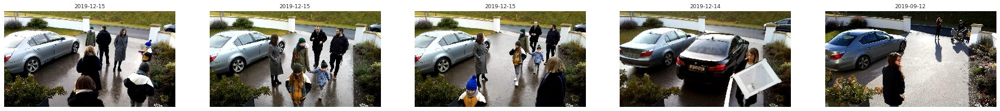

***************************
Model: nsamples25000_res56_blurTrue_threshFalse_polyTrue
Number of anomalies stored: 15, top 5 errors:


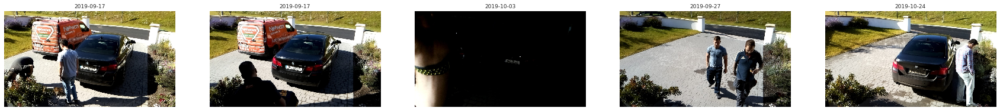

***************************
Model: nsamples25000_res56_blurTrue_threshTrue_polyFalse
Number of anomalies stored: 15, top 5 errors:


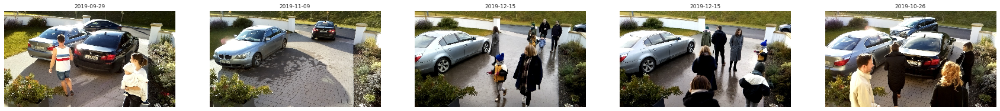

***************************
Model: nsamples25000_res56_blurTrue_threshTrue_polyTrue
Number of anomalies stored: 15, top 5 errors:


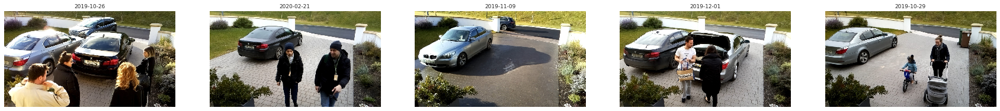

***************************
Model: nsamples50000_res28_blurFalse_threshFalse_polyFalse
Number of anomalies stored: 30, top 5 errors:


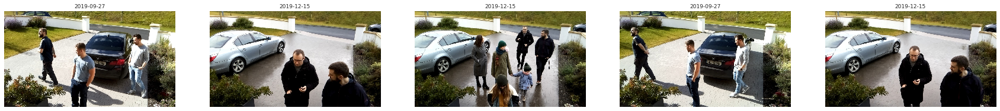

***************************
Model: nsamples50000_res28_blurFalse_threshFalse_polyTrue
Number of anomalies stored: 30, top 5 errors:


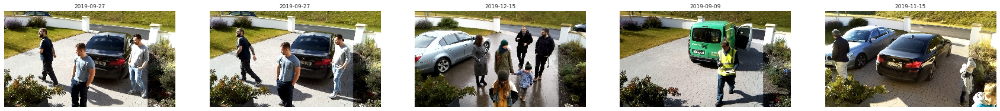

***************************
Model: nsamples50000_res28_blurFalse_threshTrue_polyFalse
Number of anomalies stored: 30, top 5 errors:


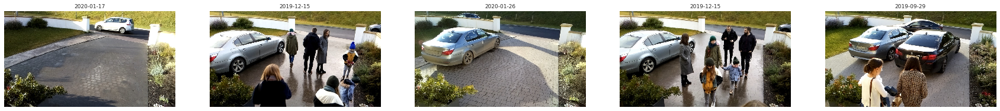

***************************
Model: nsamples50000_res28_blurFalse_threshTrue_polyTrue
Number of anomalies stored: 30, top 5 errors:


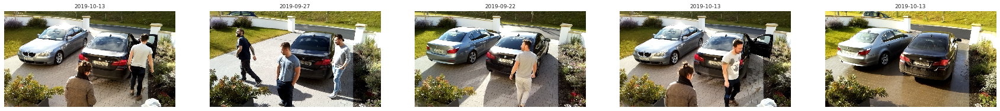

***************************
Model: nsamples50000_res28_blurTrue_threshFalse_polyFalse
Number of anomalies stored: 30, top 5 errors:


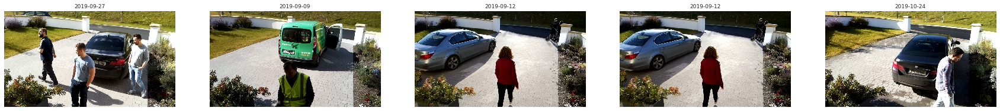

***************************
Model: nsamples50000_res28_blurTrue_threshFalse_polyTrue
Number of anomalies stored: 30, top 5 errors:


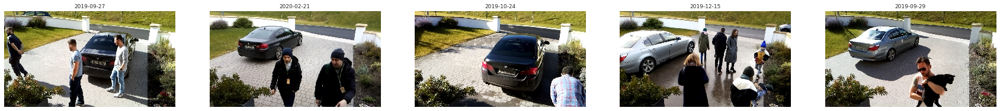

***************************
Model: nsamples50000_res28_blurTrue_threshTrue_polyFalse
Number of anomalies stored: 30, top 5 errors:


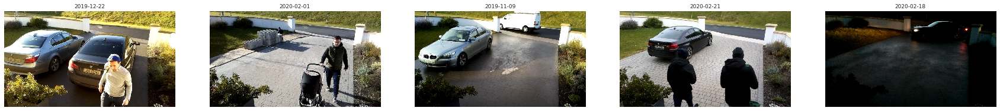

***************************
Model: nsamples50000_res28_blurTrue_threshTrue_polyTrue
Number of anomalies stored: 30, top 5 errors:


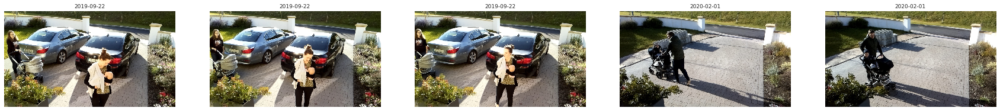

***************************
Model: nsamples50000_res56_blurFalse_threshFalse_polyFalse
Number of anomalies stored: 30, top 5 errors:


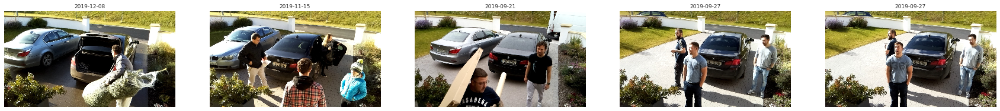

***************************
Model: nsamples50000_res56_blurFalse_threshFalse_polyTrue
Number of anomalies stored: 30, top 5 errors:


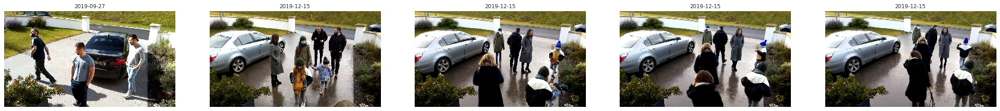

***************************
Model: nsamples50000_res56_blurFalse_threshTrue_polyFalse
Number of anomalies stored: 30, top 5 errors:


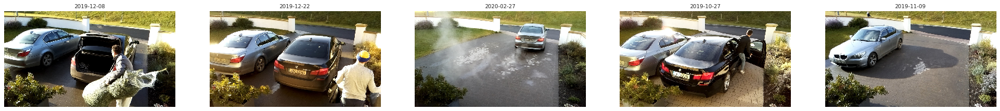

***************************
Model: nsamples50000_res56_blurFalse_threshTrue_polyTrue
Number of anomalies stored: 30, top 5 errors:


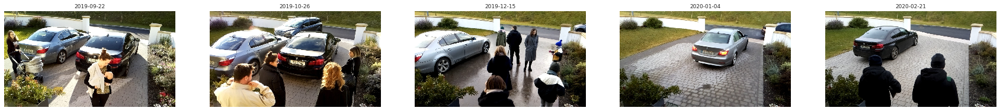

***************************
Model: nsamples50000_res56_blurTrue_threshFalse_polyFalse
Number of anomalies stored: 30, top 5 errors:


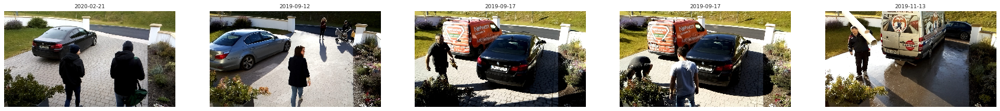

***************************
Model: nsamples50000_res56_blurTrue_threshFalse_polyTrue
Number of anomalies stored: 30, top 5 errors:


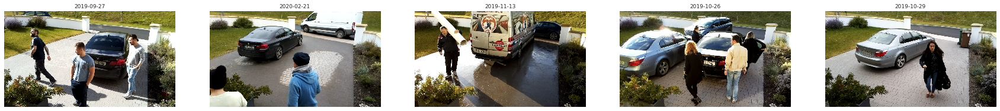

***************************
Model: nsamples50000_res56_blurTrue_threshTrue_polyFalse
Number of anomalies stored: 30, top 5 errors:


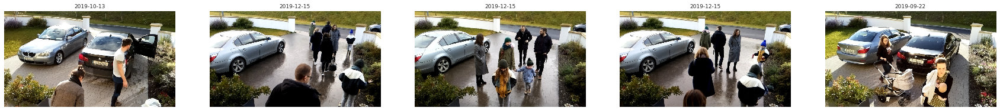

***************************
Model: nsamples50000_res56_blurTrue_threshTrue_polyTrue
Number of anomalies stored: 30, top 5 errors:


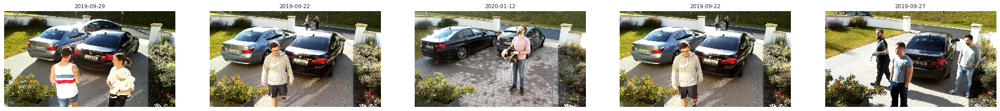

***************************


In [57]:
RES_DIR = '../Datasets/anomaly_results'
for f in sorted(os.listdir(RES_DIR)):
    fname = f'{RES_DIR}/{f}'
    df = pd.read_csv(fname)
    anomalies = df[df['is_anomaly'] == 'Y']
    print(f'Model: {f.replace(".csv", "")}')
    print(f'Number of anomalies stored: {anomalies.shape[0]}, top 5 errors:')
    plt.figure(figsize=(30,10)) # specifying the overall grid size
    for i, img_path in enumerate(anomalies['y_test'].values[:5]):
        plt.subplot(1, 5, i+1) # the number of images in the grid is 1*5
        img = cv2.imread(img_path)
        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.title(f'{img_path.split("/")[4]}', fontsize=9)
        plt.axis('off')
    plt.show()
    print('***************************')